<a href="https://colab.research.google.com/github/5ury4pr454th/building-scene-classification/blob/main/Detect_and_Save_Test.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Importing Files

In [ ]:
#@title
# For running inference on the TF-Hub module.
import tensorflow as tf
import tensorflow_hub as hub

# for mounting drive and basic file navigation
import os
from google.colab import drive

# for saving csv
import pandas as pd

# For downloading the image.
import matplotlib.pyplot as plt
import tempfile
from six.moves.urllib.request import urlopen
from six import BytesIO

# for additional dictionary tools
from collections import Counter

# For drawing onto the image.
import numpy as np
from PIL import Image
from PIL import ImageColor
from PIL import ImageDraw
from PIL import ImageFont
from PIL import ImageOps

# For measuring the inference time.
import time

# Print Tensorflow version
print(tf.__version__)

# Check available GPU devices.
print("The following GPU devices are available: %s" % tf.test.gpu_device_name())

# mounting drive for using stored data
drive.mount('/content/gdrive')

2.8.2
The following GPU devices are available: /device:GPU:0
Mounted at /content/gdrive


## Defining some functions for image preprocessing

In [ ]:
#@title
def display_image(image):
  fig = plt.figure(figsize=(20, 15))
  plt.grid(False)
  plt.axis('off')
  plt.imshow(image)

def download_and_resize_image(url, new_width=256, new_height=256,
                              display=False):
  _, filename = tempfile.mkstemp(suffix=".jpg")
  response = urlopen(url)
  image_data = response.read()
  image_data = BytesIO(image_data)
  pil_image = Image.open(image_data)
  pil_image = ImageOps.fit(pil_image, (new_width, new_height), Image.ANTIALIAS)
  pil_image_rgb = pil_image.convert("RGB")
  pil_image_rgb.save(filename, format="JPEG", quality=90)
  print("Image downloaded to %s." % filename)
  if display:
    display_image(pil_image)
  return filename

def draw_bounding_box_on_image(image,
                               ymin,
                               xmin,
                               ymax,
                               xmax,
                               color,
                               font,
                               thickness=4,
                               display_str_list=()):
  """Adds a bounding box to an image."""
  draw = ImageDraw.Draw(image)
  im_width, im_height = image.size
  (left, right, top, bottom) = (xmin * im_width, xmax * im_width,
                                ymin * im_height, ymax * im_height)
  draw.line([(left, top), (left, bottom), (right, bottom), (right, top),
             (left, top)],
            width=thickness,
            fill=color)

  # If the total height of the display strings added to the top of the bounding
  # box exceeds the top of the image, stack the strings below the bounding box
  # instead of above.
  display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
  # Each display_str has a top and bottom margin of 0.05x.
  total_display_str_height = (1 + 2 * 0.05) * sum(display_str_heights)

  if top > total_display_str_height:
    text_bottom = top
  else:
    text_bottom = top + total_display_str_height
  # Reverse list and print from bottom to top.
  for display_str in display_str_list[::-1]:
    text_width, text_height = font.getsize(display_str)
    margin = np.ceil(0.05 * text_height)
    draw.rectangle([(left, text_bottom - text_height - 2 * margin),
                    (left + text_width, text_bottom)],
                   fill=color)
    draw.text((left + margin, text_bottom - text_height - margin),
              display_str,
              fill="black",
              font=font)
    text_bottom -= text_height - 2 * margin

def draw_boxes(image, boxes, class_names, scores, max_boxes=15, min_score=0.2):
  """Overlay labeled boxes on an image with formatted scores and label names."""
  colors = list(ImageColor.colormap.values())

  try:
    font = ImageFont.truetype("/usr/share/fonts/truetype/liberation/LiberationSansNarrow-Regular.ttf",
                              25)
  except IOError:
    print("Font not found, using default font.")
    font = ImageFont.load_default()

  for i in range(min(boxes.shape[0], max_boxes)):
    if scores[i] >= min_score:
      ymin, xmin, ymax, xmax = tuple(boxes[i])
      display_str = "{}: {}%".format(class_names[i].decode("ascii"),
                                     int(100 * scores[i]))
      color = colors[hash(class_names[i]) % len(colors)]
      image_pil = Image.fromarray(np.uint8(image)).convert("RGB")
      draw_bounding_box_on_image(
          image_pil,
          ymin,
          xmin,
          ymax,
          xmax,
          color,
          font,
          display_str_list=[display_str])
      np.copyto(image, np.array(image_pil))
  return image

def load_img(path):
  img = tf.io.read_file(path)
  img = tf.image.decode_jpeg(img, channels=3)
  return img

def run_detector(detector, path, show = False):
  img = load_img(path)

  converted_img  = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]
  start_time = time.time()
  result = detector(converted_img)
  end_time = time.time()

  result = {key:value.numpy() for key,value in result.items()}

  print("Found %d objects." % len(result["detection_scores"]))
  print("Inference time: ", end_time-start_time)

  image_with_boxes = draw_boxes(
      img.numpy(), result["detection_boxes"],
      result["detection_class_entities"], result["detection_scores"])
  if show:
    display_image(image_with_boxes)

  return result["detection_boxes"], result["detection_class_entities"], result["detection_scores"]

def resize_and_save(image_path, final_path, width, height):
  pil_image = Image.open(image_path)
  pil_image = ImageOps.fit(pil_image, (width, height), Image.ANTIALIAS)
  pil_image_rgb = pil_image.convert("RGB")
  pil_image_rgb.save(final_path, format="JPEG", quality=90)
  pass

def crop_bounding_box(img, bounding_box):
  ymin, xmin, ymax, xmax = tuple(bounding_box)
  return img.crop((xmin, ymin, xmax, ymax))

def fit_and_save(img, final_path, width, height):
    cropped_img = ImageOps.fit(img, (width, height), Image.ANTIALIAS)
    cropped_img_rgb = cropped_img.convert("RGB")
    cropped_img_rgb.save(final_path, format="JPEG", quality=90)
    pass


def do_operations(filename):
    
  # open image file
  img = Image.open(filename)
  
  # rescale image 
  img = ImageOps.fit(img, (resized_img_size, resized_img_size), Image.ANTIALIAS)
  
  # convert to RGB if not
  img = img.convert("RGB")
  
  np_img = np.array(img)
  
  return np_img

## Preprocessing

In [ ]:
# classes = ["residential", "mixed", "commercial","others","industrial"]
# images_path = '/content/gdrive/Othercomputers/My Laptop/Dataset Images/scenes/test/'
# renamed_images_path = '/content/gdrive/Othercomputers/My Laptop/Dataset Images/scenes/test_renamed/'
# for bclass in classes:
#   for index, each_test_scene in enumerate(os.listdir(renamed_images_path + bclass)):
#     os.rename(renamed_images_path + bclass + '/' + each_test_scene, renamed_images_path + bclass + '/' + 't_' + bclass[0] + '_' + str(index) +'.jpg')

In [ ]:
# image_path = "/content/gdrive/Othercomputers/My Laptop/Dataset Images/scenes/to be detected"

resized_street_image_dims_width = 700
resized_street_image_dims_height = 450

# for every_file in os.listdir(image_path):
#     resize_and_save(image_path + '/' + every_file, image_path + '/' + every_file, resized_street_image_dims_width, resized_street_image_dims_height)

In [ ]:
classes = ["residential", "mixed", "commercial","others","industrial"]

In [ ]:
# images_path = '/content/gdrive/Othercomputers/My Laptop/Dataset Images/scenes/test_renamed/all'
resized_images_path = '/content/gdrive/Othercomputers/My Laptop/Dataset Images/scenes/test_renamed/all_resized'

resized_street_image_dims_width = 700
resized_street_image_dims_height = 450

# for every_file in os.listdir(images_path):
#     resize_and_save(images_path + '/' + every_file, resized_images_path + '/' + every_file, resized_street_image_dims_width, resized_street_image_dims_height)

## Detection using pretrained model

In [ ]:
module_handle = "https://tfhub.dev/google/faster_rcnn/openimages_v4/inception_resnet_v2/1"
detector = hub.load(module_handle).signatures['default']

INFO:tensorflow:Saver not created because there are no variables in the graph to restore


INFO:tensorflow:Saver not created because there are no variables in the graph to restore


In [ ]:
resized_img_size = 500
cropped_dims = 800
frequency_dict = dict()
predicted_dict = {}
resized_street_image_dims = 800
instances_folder = "/content/gdrive/Othercomputers/My Laptop/Dataset Images/instances/test"

resized_images_path = '/content/gdrive/Othercomputers/My Laptop/Dataset Images/scenes/test_renamed/all_resized'

In [ ]:
expansions = [resized_street_image_dims_height, resized_street_image_dims_width, resized_street_image_dims_height, resized_street_image_dims_width]

Found 100 objects.
Inference time:  37.35216951370239
Found 100 objects.
Inference time:  0.9345765113830566
Found 100 objects.
Inference time:  0.9286925792694092
Found 100 objects.
Inference time:  0.9272303581237793
Found 100 objects.
Inference time:  0.91538405418396
Found 100 objects.
Inference time:  0.9195876121520996
Found 100 objects.
Inference time:  0.9126639366149902
Found 100 objects.
Inference time:  0.9155805110931396
Found 100 objects.
Inference time:  0.9187326431274414
Found 100 objects.
Inference time:  0.9091997146606445
Found 100 objects.
Inference time:  0.912696123123169
Found 100 objects.
Inference time:  0.911625862121582
Found 100 objects.
Inference time:  0.9183881282806396
Found 100 objects.
Inference time:  0.915043830871582
Found 100 objects.
Inference time:  0.9205195903778076
Found 100 objects.
Inference time:  0.9166405200958252
Found 100 objects.
Inference time:  0.9216082096099854
Found 100 objects.
Inference time:  0.9192860126495361
Found 100 object

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


Found 100 objects.
Inference time:  0.9216318130493164
Found 100 objects.
Inference time:  0.9228992462158203
Found 100 objects.
Inference time:  0.9195733070373535
Found 100 objects.
Inference time:  0.9236791133880615
Found 100 objects.
Inference time:  0.9129283428192139
Found 100 objects.
Inference time:  0.9258542060852051
Found 100 objects.
Inference time:  0.9239211082458496
Found 100 objects.
Inference time:  0.9159603118896484
Found 100 objects.
Inference time:  0.9182982444763184
Found 100 objects.
Inference time:  0.9168157577514648
Found 100 objects.
Inference time:  0.9186787605285645
Found 100 objects.
Inference time:  0.9198348522186279
Found 100 objects.
Inference time:  0.9189140796661377
Found 100 objects.
Inference time:  0.9288957118988037
Found 100 objects.
Inference time:  0.9188692569732666
Found 100 objects.
Inference time:  0.9160075187683105
Found 100 objects.
Inference time:  0.9185571670532227
Found 100 objects.
Inference time:  0.9192371368408203
Found 100 

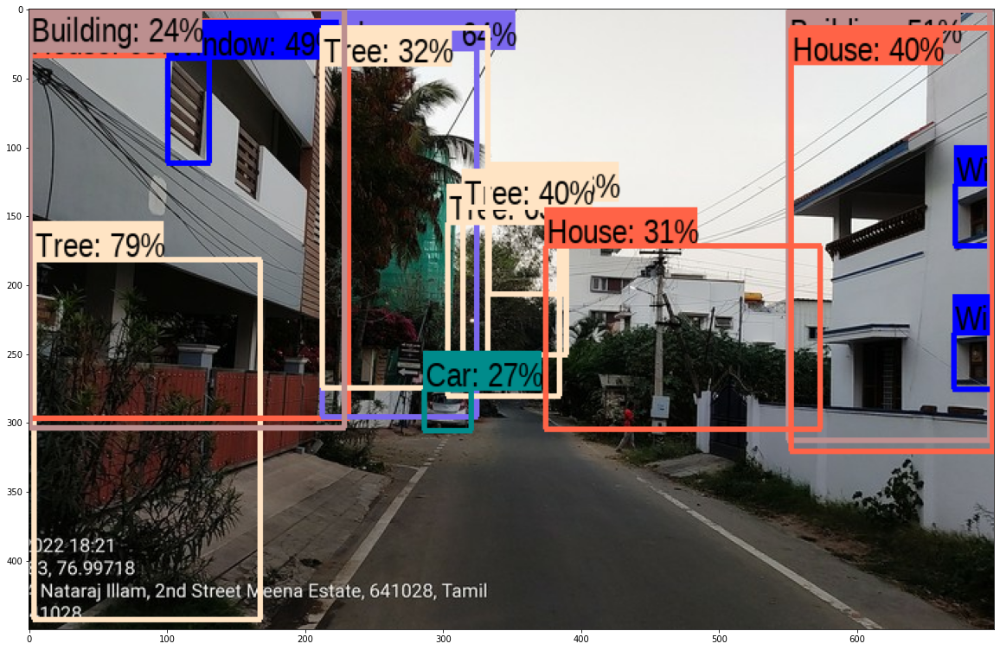

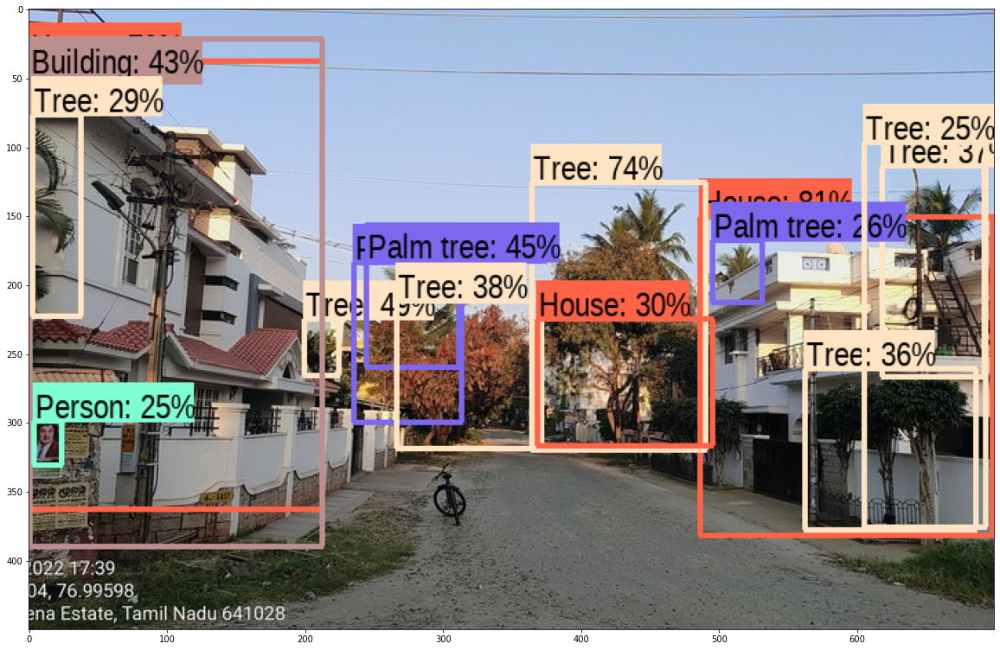

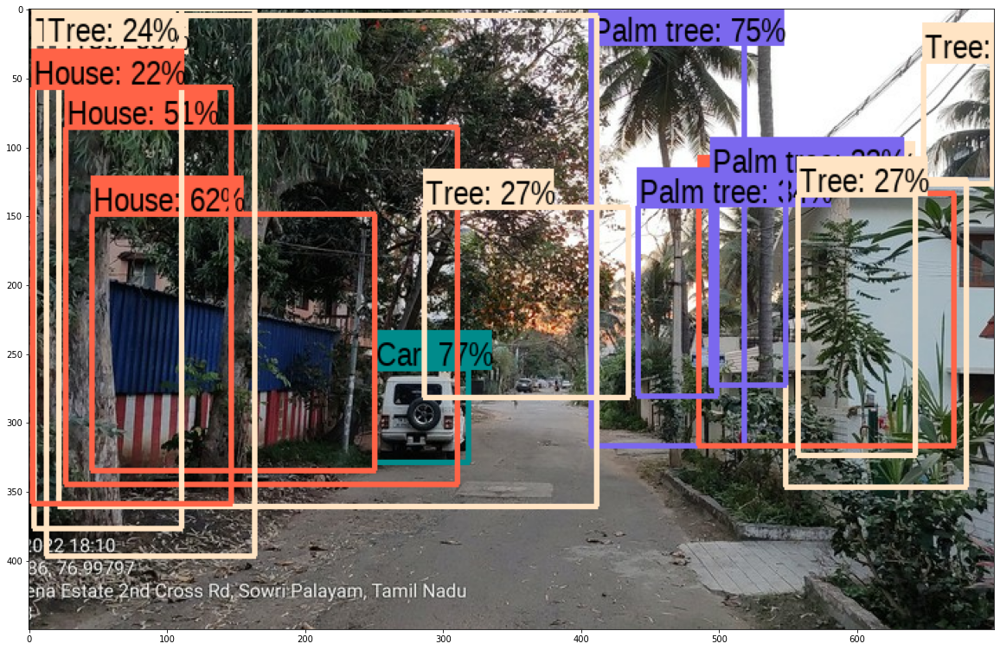

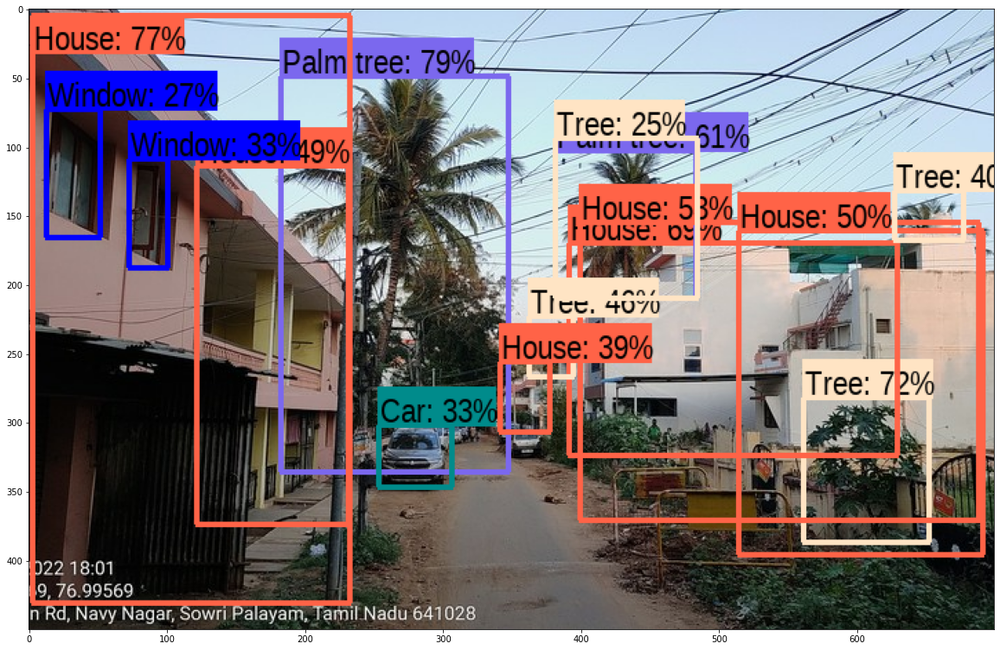

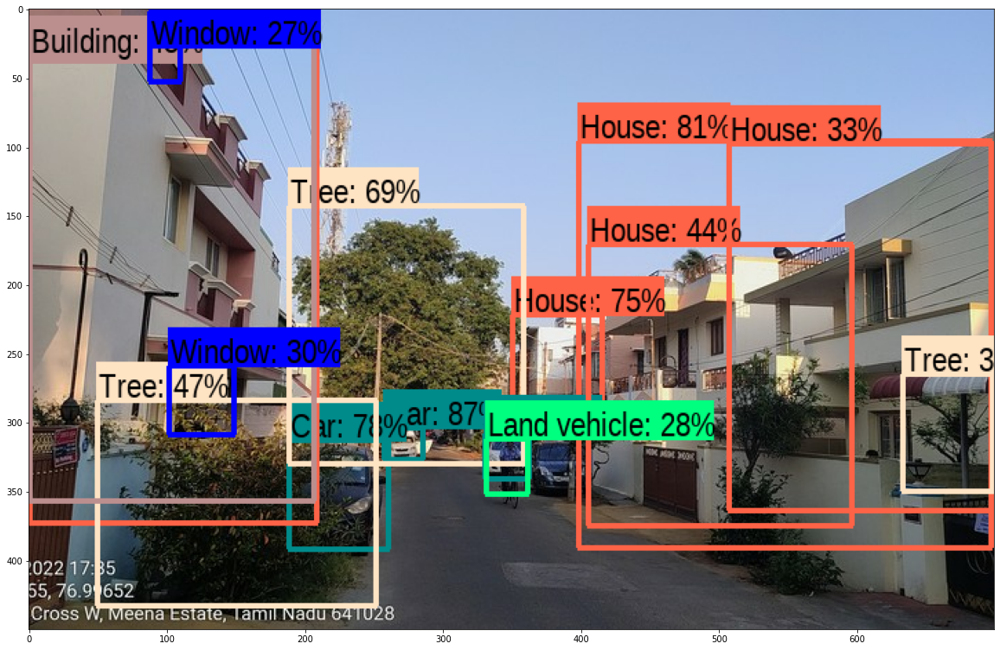

...

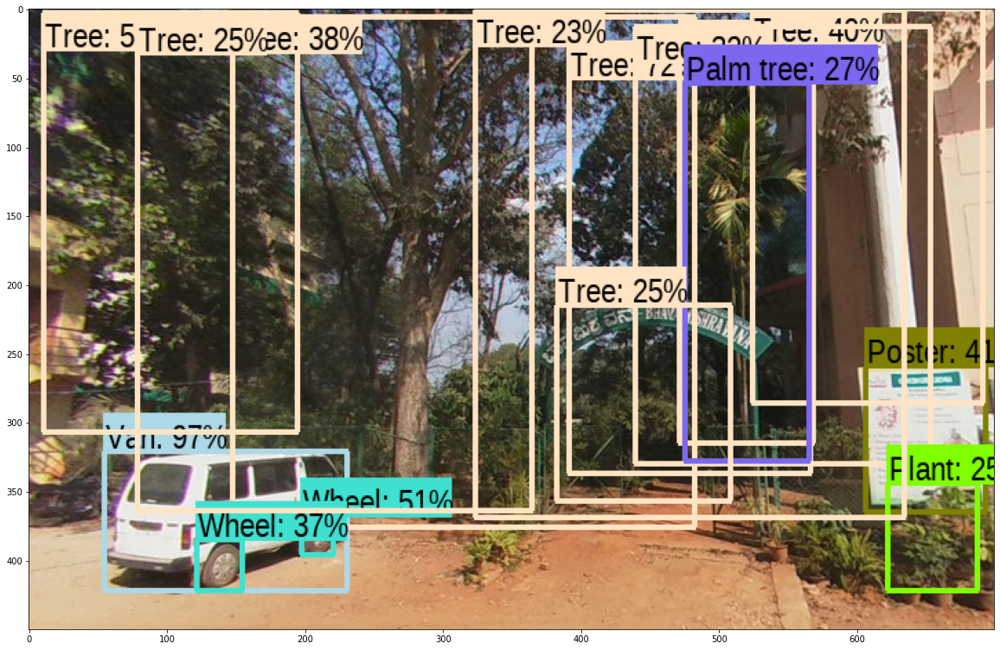

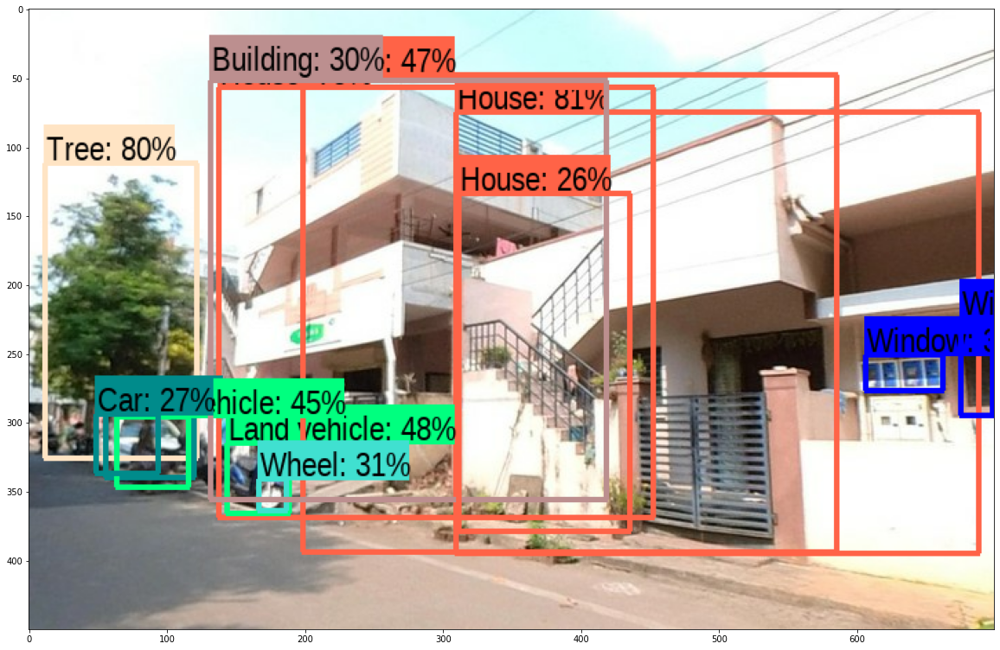

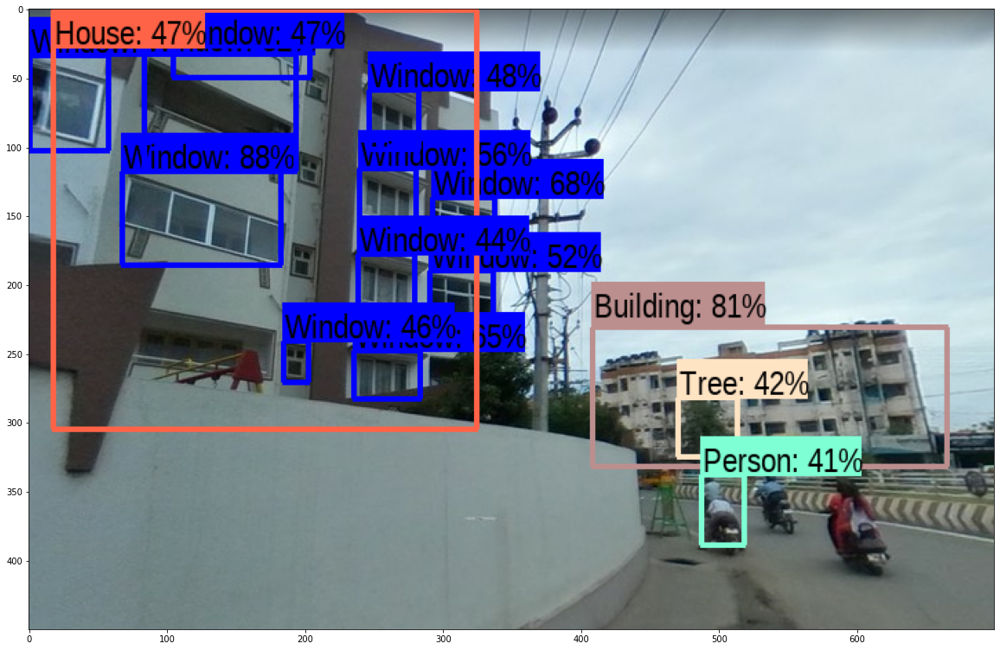

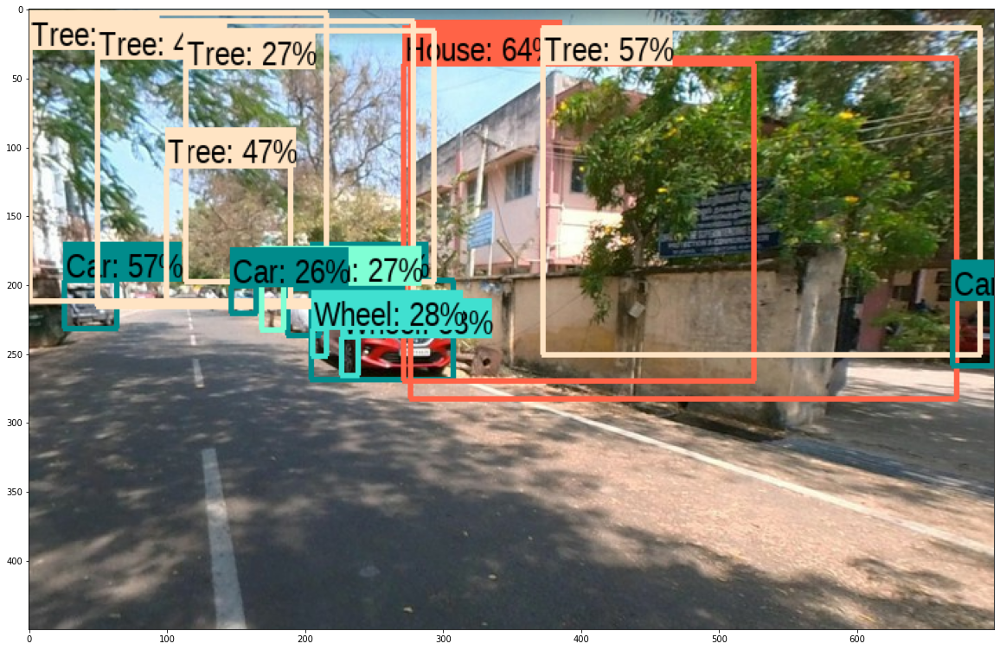

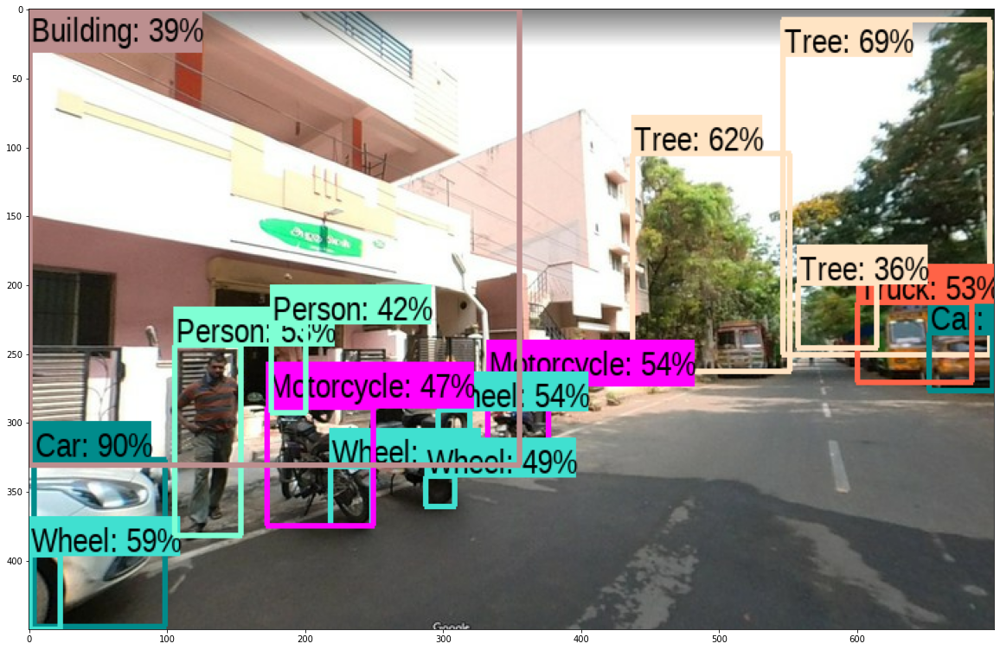

Buffered data was truncated after reaching the output size limit.

In [ ]:
for bclass in classes:

  for i in os.listdir(resized_images_path +'/'+ bclass + '/'):
    
    predicted_dict[bclass +'/' + i] = []    
    bounding_objects = []
    
    # for each image, run the detector and get the bounding boxes and corresponding
    img = Image.open(resized_images_path + '/'+ bclass + '/' + i)
    bounding_boxes, raw_bounding_classes, class_scores = run_detector(detector, resized_images_path + '/' + bclass + '/' + i)
    
    # for each of the objects detected, check if house, skyscraper or building, crop according to priority, and save them to the cropped_folder
    for index, i3 in enumerate(raw_bounding_classes):
      i1 = str(i3)[2:-1].lower()
      if i1 in ['house', 'building', 'skyscraper', 'tower'] and class_scores[index] > 0.3:
        final_path = instances_folder + "/" + bclass + '/' + str(index) + '_' + i
        expanded_boxes = np.asarray(tuple(expansions)) * np.asarray(bounding_boxes[index])
        house_bound = crop_bounding_box(img, expanded_boxes)
        house_bound = fit_and_save(house_bound, final_path, 500, 700)
    
    for objects in range(len(raw_bounding_classes)):
      if class_scores[objects] >= 0.4:
        bounding_objects.append(str(raw_bounding_classes[objects])[2:-1].lower())
    
    # record the number of objects detected
    frequency_dict[bclass +'/' + i] = Counter(bounding_objects)